In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import statsmodels.api as sm

In [2]:
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression,Ridge,Lasso
from sklearn.preprocessing import StandardScaler
from sklearn.svm import SVR

In [3]:
from sklearn import tree
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor,AdaBoostRegressor, GradientBoostingRegressor

In [4]:
from sklearn.model_selection import GridSearchCV

In [5]:
import graphviz
import pickle

In [6]:
## method to plot grid cv results
def plotGridCV(grid_cv):
    cv_results = pd.DataFrame(grid_cv.cv_results_)
    for param in grid_cv.best_params_.keys():
        result_subset = cv_results
        title_arr = []
        for param_p in grid_cv.best_params_.keys():
            if param_p == param: continue
            result_subset = result_subset[result_subset["param_"+param_p] == grid_cv.best_params_[param_p]]
            title_arr.append("{0}: {1}".format(param_p,grid_cv.best_params_[param_p]))
        plt.plot(result_subset["param_"+param],result_subset['mean_test_score'])
        plt.plot(result_subset["param_"+param],result_subset['mean_train_score'])
        plt.xlabel(param)
        plt.title(", ".join(title_arr))
        plt.show()

In [6]:
data = pd.read_csv('energydata_complete.csv')

In [7]:
data.head()

,date,Appliances,lights,T1,RH_1,T2,RH_2,T3,RH_3,T4,...,T9,RH_9,T_out,Press_mm_hg,RH_out,Windspeed,Visibility,Tdewpoint,rv1,rv2
0,2016-01-11 17:00:00,60,30,19.89,47.596667,19.2,44.790000,19.79,44.730000,19.000000,...,17.033333,45.53,6.600000,733.5,92.0,7.000000,63.000000,5.3,13.275433,13.275433
1,2016-01-11 17:10:00,60,30,19.89,46.693333,19.2,44.722500,19.79,44.790000,19.000000,...,17.066667,45.56,6.483333,733.6,92.0,6.666667,59.166667,5.2,18.606195,18.606195
2,2016-01-11 17:20:00,50,30,19.89,46.300000,19.2,44.626667,19.79,44.933333,18.926667,...,17.000000,45.50,6.366667,733.7,92.0,6.333333,55.333333,5.1,28.642668,28.642668
3,2016-01-11 17:30:00,50,40,19.89,46.066667,19.2,44.590000,19.79,45.000000,18.890000,...,17.000000,45.40,6.250000,733.8,92.0,6.000000,51.500000,5.0,45.410389,45.410389
4,2016-01-11 17:40:00,60,40,19.89,46.333333,19.2,44.530000,19.79,45.000000,18.890000,...,17.000000,45.40,6.133333,733.9,92.0,5.666667,47.666667,4.9,10.084097,10.084097


In [8]:
data.date = pd.to_datetime(data.date)
data['month'] = data.date.dt.month
data['day'] = data.date.dt.day
data['hour'] = data.date.dt.hour
data['minute'] = data.date.dt.minute
data['second'] = data.date.dt.second

data['week'] = data.date.dt.isocalendar().week.astype(int)
data['day_of_week'] = data.date.dt.dayofweek
data['is_weekend'] = (data.day_of_week >= 5 ).astype(int)

# data['Appliances_LAGGED'] = data['Appliances'].shift(1)

# data.drop(data.index[0],inplace=True)
data.drop('date',axis=1, inplace=True)

In [9]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 19735 entries, 0 to 19734
Data columns (total 36 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   Appliances   19735 non-null  int64  
 1   lights       19735 non-null  int64  
 2   T1           19735 non-null  float64
 3   RH_1         19735 non-null  float64
 4   T2           19735 non-null  float64
 5   RH_2         19735 non-null  float64
 6   T3           19735 non-null  float64
 7   RH_3         19735 non-null  float64
 8   T4           19735 non-null  float64
 9   RH_4         19735 non-null  float64
 10  T5           19735 non-null  float64
 11  RH_5         19735 non-null  float64
 12  T6           19735 non-null  float64
 13  RH_6         19735 non-null  float64
 14  T7           19735 non-null  float64
 15  RH_7         19735 non-null  float64
 16  T8           19735 non-null  float64
 17  RH_8         19735 non-null  float64
 18  T9           19735 non-null  float64
 19  RH_9

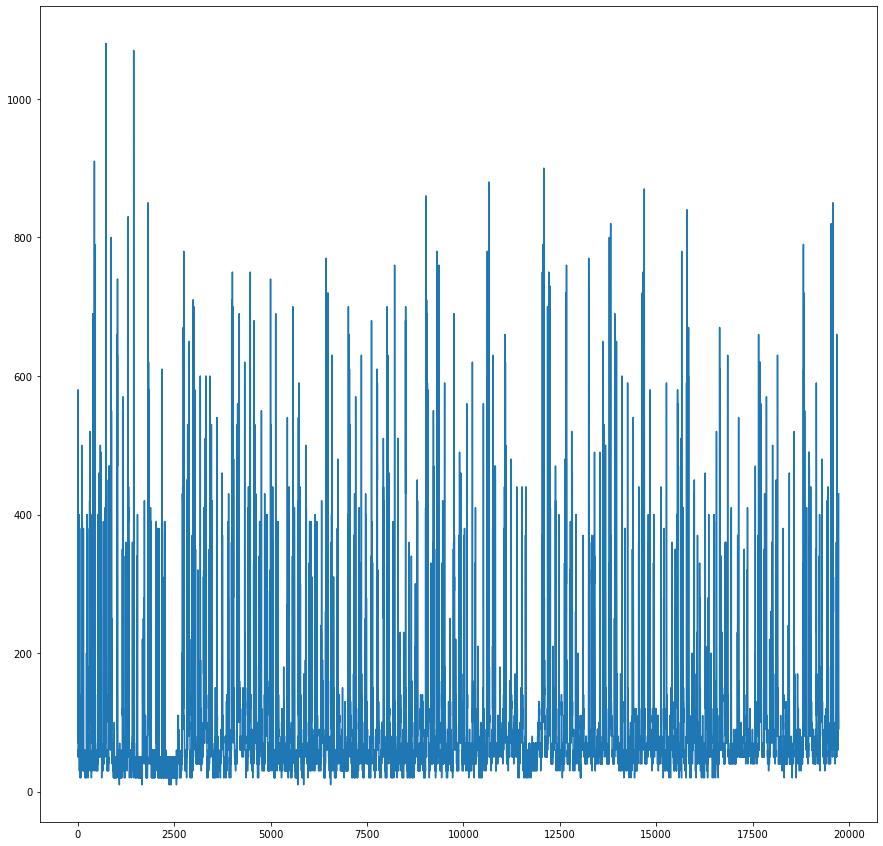

In [10]:
plt.figure(figsize=(15,15))
plt.plot(data['Appliances'])

In [11]:
train_data, test_data = train_test_split(data, test_size = 0.3)

In [12]:
train_data.describe(percentiles=[0.05,0.25,0.50,0.75,0.95])

,Appliances,lights,T1,RH_1,T2,RH_2,T3,RH_3,T4,RH_4,...,rv1,rv2,month,day,hour,minute,second,week,day_of_week,is_weekend
count,13814.000000,13814.000000,13814.000000,13814.000000,13814.000000,13814.000000,13814.000000,13814.000000,13814.000000,13814.000000,...,13814.000000,13814.000000,13814.000000,13814.000000,13814.000000,13814.000000,13814.0,13814.000000,13814.000000,13814.000000
mean,98.091791,3.795425,21.687176,40.267231,20.349507,40.403726,22.263564,39.232155,20.864116,39.018797,...,25.013640,25.013640,3.102505,16.055089,11.481106,25.020269,0.0,11.396627,2.978934,0.277617
std,101.944783,7.935826,1.615999,3.992968,2.208916,4.066898,2.009245,3.248029,2.050700,4.328178,...,14.458320,14.458320,1.340978,8.418870,6.903218,17.089593,0.0,5.668590,1.984609,0.447840
min,10.000000,0.000000,16.790000,27.023333,16.100000,20.596667,17.200000,28.766667,15.100000,27.660000,...,0.005322,0.005322,1.000000,1.000000,0.000000,0.000000,0.0,2.000000,0.000000,0.000000
5%,30.000000,0.000000,19.100000,34.700000,17.323333,33.400000,19.500000,34.760000,17.790000,33.000000,...,2.396319,2.396319,1.000000,2.000000,1.000000,0.000000,0.0,3.000000,0.000000,0.000000
25%,50.000000,0.000000,20.730000,37.346964,18.790000,37.886250,20.790000,36.868571,19.566667,35.530000,...,12.616692,12.616692,2.000000,9.000000,6.000000,10.000000,0.0,7.000000,1.000000,0.000000
50%,60.000000,0.000000,21.600000,39.626667,20.000000,40.466667,22.100000,38.530000,20.666667,38.400000,...,24.949705,24.949705,3.000000,16.000000,11.000000,20.000000,0.0,11.000000,3.000000,0.000000
75%,100.000000,0.000000,22.600000,43.090000,21.530000,43.230000,23.308750,41.766071,22.100000,42.163333,...,37.598670,37.598670,4.000000,23.000000,17.000000,40.000000,0.0,16.000000,5.000000,1.000000
95%,330.000000,20.000000,24.758818,47.367417,24.600000,46.649083,26.200000,45.090000,24.600000,46.700000,...,47.498010,47.498010,5.000000,29.000000,22.000000,50.000000,0.0,20.000000,6.000000,1.000000
max,1070.000000,70.000000,26.260000,63.360000,29.856667,54.766667,29.198571,50.163333,26.200000,51.063333,...,49.996530,49.996530,5.000000,31.000000,23.000000,50.000000,0.0,21.000000,6.000000,1.000000


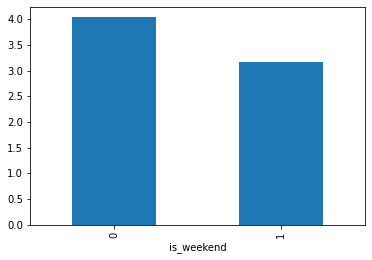

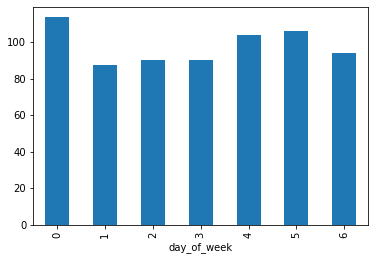

In [14]:
train_data.groupby('is_weekend').mean().loc[:,'lights'].plot.bar()
plt.show()

train_data.groupby('day_of_week').mean().loc[:,'Appliances'].plot.bar()
plt.show()

Weekdays have shown higher consumption of light than weekends. But energy consumption is almost same across the week.

<AxesSubplot:>

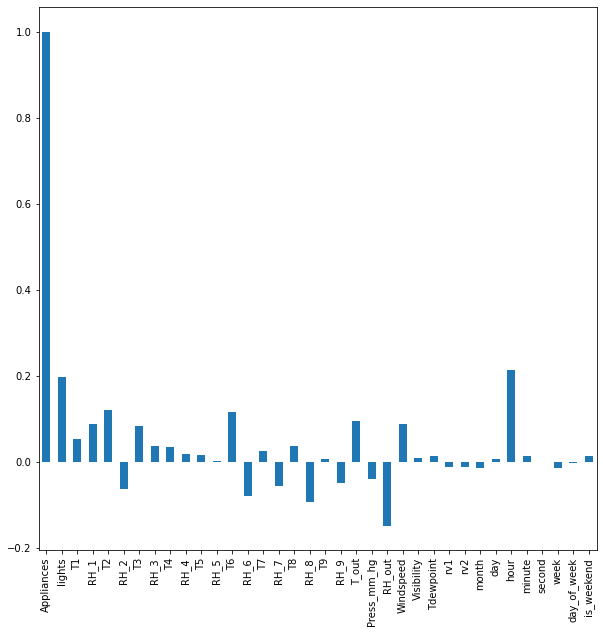

In [15]:
plt.figure(figsize=(10,10))
train_data.corr()['Appliances'].plot.bar()

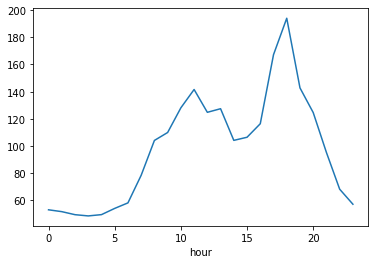

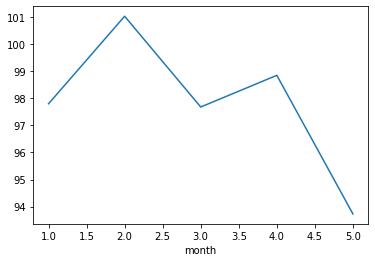

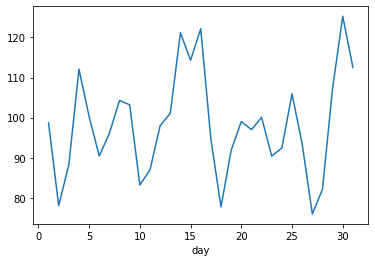

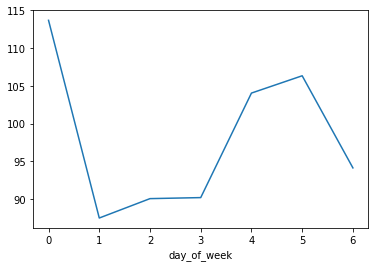

In [16]:
train_data.groupby(train_data.hour).mean()['Appliances'].plot()
plt.show()
train_data.groupby(train_data.month).mean()['Appliances'].plot()
plt.show()
train_data.groupby(train_data.day).mean()['Appliances'].plot()
plt.show()
train_data.groupby(train_data.day_of_week).mean()['Appliances'].plot()
plt.show()

Power consumption seems to increase in evening
Power consumption variying uniformly across the month
Downward trend shown from month 1 to 5
Upward consumption trend shown in week from tuesday to saturday

C:\Users\jatin.bhola\AppData\Local\Continuum\anaconda3\lib\site-packages\pandas\plotting\_matplotlib\core.py:1235: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(xticklabels)


<AxesSubplot:xlabel='month,day'>

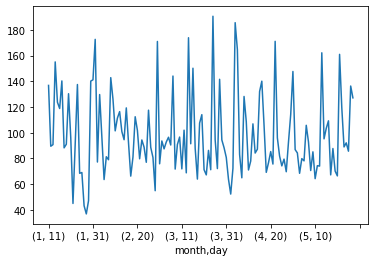

In [17]:
train_data.groupby([train_data.month,train_data.day]).mean()['Appliances'].plot()

Average consumption varying uniformly for all days

<AxesSubplot:>

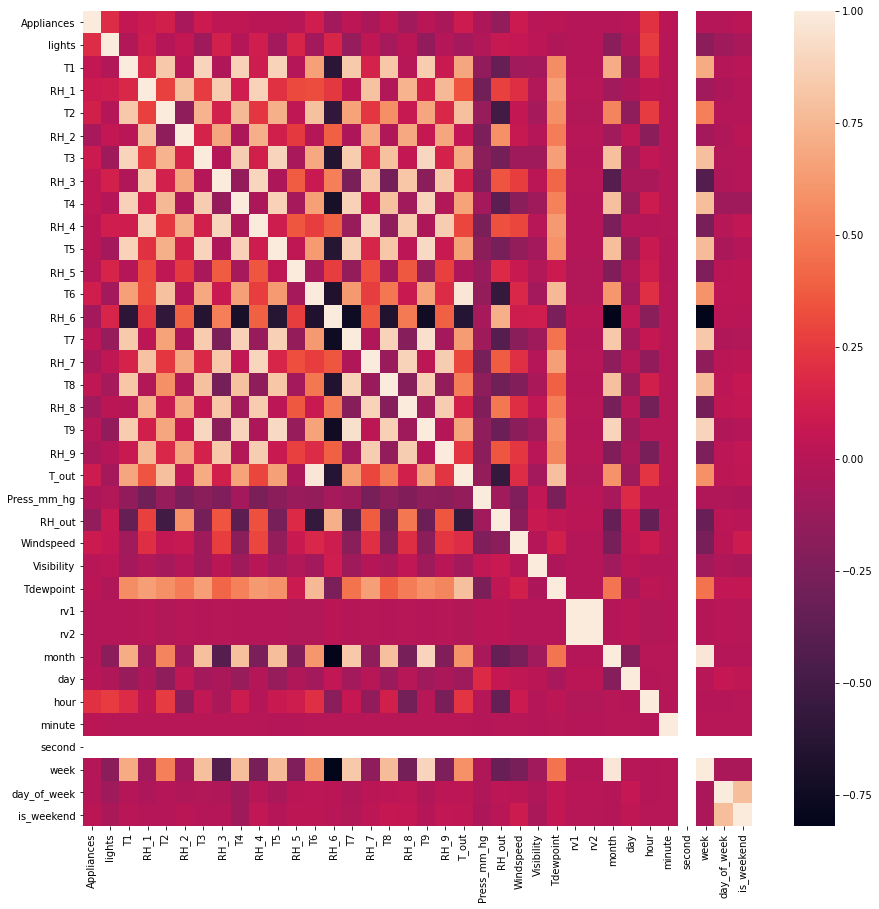

In [18]:
plt.figure(figsize=(15,15))
sns.heatmap(train_data.corr())

In [13]:
stdScaler = StandardScaler()
train_data = pd.DataFrame(stdScaler.fit_transform(train_data),columns=data.columns)
test_data = pd.DataFrame(stdScaler.transform(test_data),columns=data.columns)

In [14]:
train_y = train_data['Appliances']
train_x = train_data.drop('Appliances',axis=1)

In [15]:
test_y = test_data['Appliances']
test_x = test_data.drop('Appliances',axis=1)

### Default Linear Regression Model

In [22]:
lr_model = LinearRegression()
lr_model.fit(train_x, train_y)

LinearRegression()

In [23]:
lr_model.score(train_x, train_y)

0.17704352557231762

In [24]:
lr_model.score(test_x, test_y)

0.1637943350229848

#### Very poor performance

In [25]:
model = sm.OLS(train_y,sm.add_constant(train_x))
result = model.fit()
result.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:             Appliances   R-squared:                       0.177
Model:                            OLS   Adj. R-squared:                  0.175
Method:                 Least Squares   F-statistic:                     89.83
Date:                Sun, 18 Oct 2020   Prob (F-statistic):               0.00
Time:                        15:10:14   Log-Likelihood:                -18255.
No. Observations:               13814   AIC:                         3.658e+04
Df Residuals:                   13780   BIC:                         3.683e+04
Df Model:                          33                                         
Covariance Type:            nonrobust                                         
===============================================================================
                  coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------------
const        1.101e-15      0.008   1.42e-13      1.000      -0.015       0.015
lights          0.1525      0.009     17.274      0.000       0.135       0.170
T1             -0.0557      0.035     -1.599      0.110      -0.124       0.013
RH_1            0.6204      0.031     19.902      0.000       0.559       0.681
T2             -0.4029      0.041     -9.825      0.000      -0.483      -0.323
RH_2           -0.6013      0.036    -16.585      0.000      -0.672      -0.530
T3              0.5602      0.026     21.827      0.000       0.510       0.611
RH_3            0.1382      0.026      5.339      0.000       0.087       0.189
T4             -0.0579      0.025     -2.325      0.020      -0.107      -0.009
RH_4           -0.0226      0.033     -0.685      0.493      -0.087       0.042
T5              0.0098      0.025      0.387      0.699      -0.040       0.060
RH_5         2.062e-05      0.009      0.002      0.998      -0.018       0.018
T6              0.3881      0.045      8.573      0.000       0.299       0.477
RH_6            0.0299      0.028      1.065      0.287      -0.025       0.085
T7              0.0302      0.033      0.920      0.358      -0.034       0.094
RH_7           -0.0730      0.026     -2.852      0.004      -0.123      -0.023
T8              0.1340      0.023      5.907      0.000       0.090       0.178
RH_8           -0.2107      0.024     -8.892      0.000      -0.257      -0.164
T9             -0.2020      0.044     -4.609      0.000      -0.288      -0.116
RH_9           -0.0100      0.021     -0.476      0.634      -0.051       0.031
T_out          -0.4522      0.097     -4.653      0.000      -0.643      -0.262
Press_mm_hg  2.916e-05      0.009      0.003      0.998      -0.018       0.019
RH_out         -0.0674      0.057     -1.189      0.234      -0.179       0.044
Windspeed       0.0364      0.010      3.647      0.000       0.017       0.056
Visibility      0.0218      0.008      2.753      0.006       0.006       0.037
Tdewpoint       0.1512      0.073      2.068      0.039       0.008       0.295
rv1            -0.0028      0.004     -0.735      0.463      -0.010       0.005
rv2            -0.0028      0.004     -0.735      0.463      -0.010       0.005
month           6.4187      0.842      7.626      0.000       4.769       8.068
day             1.3558      0.175      7.745      0.000       1.013       1.699
hour            0.0567      0.011      5.021      0.000       0.035       0.079
minute          0.0111      0.008      1.440      0.150      -0.004       0.026
second      -9.381e-15   1.22e-15     -7.683      0.000   -1.18e-14   -6.99e-15
week           -6.4199      0.822     -7.812      0.000      -8.031      -4.809
day_of_week    -0.3170      0.043     -7.364      0.000      -0.401      -0.233
is_weekend      0.0248      0.013      1.88

#### Checking for linear regression assumptions

In [26]:
train_pred = lr_model.predict(train_x)
test_pred = lr_model.predict(test_x)

In [27]:
# Mean of residuals is zero
print("train residual mean", np.mean(train_y - train_pred))
print("test residual mean", np.mean(test_y - test_pred))

train residual mean -1.0098215396452103e-16
test residual mean -0.007240254921840003


Mean of residuals is very small value close to 10^-16 which is very close to zero.

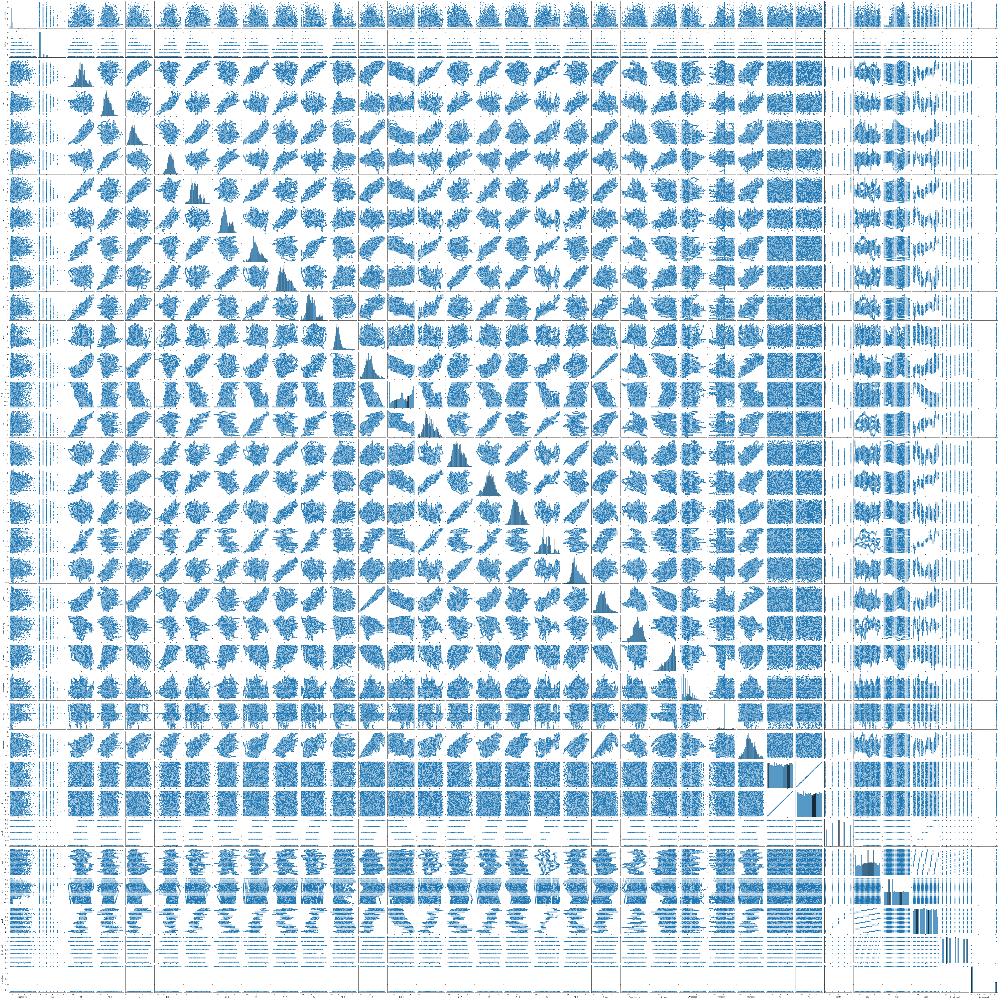

In [22]:
# Linear relationship between x and y
sns.pairplot(train_data)

No column showing linear relationship with target variable

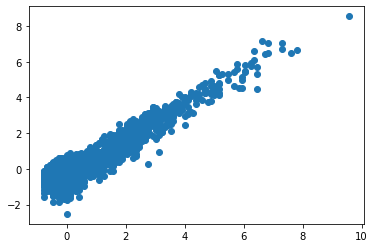

In [28]:
# Checking IID
resid = test_y - test_pred
plt.scatter(test_y,resid)

Residual errors shown dependent on target variable

<AxesSubplot:>

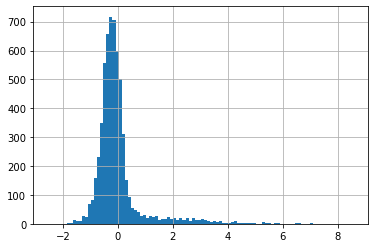

In [29]:
# checking normally distributed errors
resid.hist(bins=100)

residuals have slightly skewed normal distribution

Clearly the data is not normally distributed and hence Linear Regression model is not suitable for training on this data. Next we should try SVM because it can handle more complex relations

In [30]:
svr = SVR()
svr.fit(train_x,train_y)

SVR()

In [31]:
svr.score(train_x, train_y)

0.29025178678409225

In [31]:
svr.score(test_x, test_y)

0.24959879584385203

SVR gave slightly better performance. Will try hyperparameter tuning to see if performance can be improved.

In [32]:
parameters = {'C':[1e-1,1,1e+1,1e+2,1e+3], 'gamma':[1e-3,1e-2,1e-1,1,1e+1]}
gridCV = GridSearchCV(svr,
                      param_grid=parameters,
                      verbose=1,
                      n_jobs=-1,
                      cv=5,
                      scoring='r2',
                      return_train_score=True)
gridCV.fit(train_x, train_y)

Fitting 5 folds for each of 25 candidates, totalling 125 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  34 tasks      | elapsed:  1.3min
[Parallel(n_jobs=-1)]: Done 125 out of 125 | elapsed: 21.0min finished


GridSearchCV(cv=5, estimator=SVR(), n_jobs=-1,
             param_grid={'C': [0.1, 1, 10.0, 100.0, 1000.0],
                         'gamma': [0.001, 0.01, 0.1, 1, 10.0]},
             return_train_score=True, scoring='r2', verbose=1)

In [33]:
cv_results = pd.DataFrame(gridCV.cv_results_)

In [34]:
cv_results

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_C,param_gamma,params,split0_test_score,split1_test_score,split2_test_score,...,mean_test_score,std_test_score,rank_test_score,split0_train_score,split1_train_score,split2_train_score,split3_train_score,split4_train_score,mean_train_score,std_train_score
0,9.683200,0.084181,1.237361,0.026501,0.1,0.001,"{'C': 0.1, 'gamma': 0.001}",0.014519,-0.006198,-0.009712,...,0.004122,0.011107,19,0.005193,0.003672,0.008248,0.002121,0.004129,0.004673,0.002043
1,8.971908,0.274733,1.139801,0.040191,0.1,0.01,"{'C': 0.1, 'gamma': 0.01}",0.070945,0.056412,0.042007,...,0.063551,0.012995,16,0.069172,0.065455,0.073126,0.065930,0.063159,0.067368,0.003460
2,8.103124,0.065255,1.018750,0.015308,0.1,0.1,"{'C': 0.1, 'gamma': 0.1}",0.155971,0.127712,0.112810,...,0.140822,0.020152,13,0.168518,0.178302,0.180418,0.169342,0.172098,0.173736,0.004790
3,11.222316,0.282015,1.392818,0.050762,0.1,1,"{'C': 0.1, 'gamma': 1}",-0.027294,-0.051592,-0.053872,...,-0.042674,0.010668,24,0.034385,0.037152,0.039735,0.033947,0.038782,0.036800,0.002308
4,11.363033,0.146917,2.074149,0.040493,0.1,10,"{'C': 0.1, 'gamma': 10.0}",-0.070759,-0.092106,-0.093439,...,-0.083727,0.009199,25,0.001500,0.003802,0.005361,-0.000509,0.003843,0.002799,0.002064
5,8.534544,0.050693,1.180799,0.018320,1,0.001,"{'C': 1, 'gamma': 0.001}",0.049194,0.034921,0.026147,...,0.043061,0.010949,18,0.047209,0.042881,0.049712,0.042081,0.041613,0.044699,0.003197
6,8.503533,0.166937,1.104125,0.014279,1,0.01,"{'C': 1, 'gamma': 0.01}",0.148787,0.138485,0.114882,...,0.144358,0.017329,11,0.160125,0.157313,0.161410,0.155546,0.147925,0.156464,0.004740
7,9.895226,0.296083,1.065496,0.003522,1,0.1,"{'C': 1, 'gamma': 0.1}",0.351110,0.296128,0.309112,...,0.329812,0.028985,4,0.476527,0.477732,0.476293,0.466628,0.478273,0.475090,0.004295
8,34.774337,0.460293,1.592068,0.013930,1,1,"{'C': 1, 'gamma': 1}",0.149202,0.121321,0.113240,...,0.125564,0.014585,14,0.572700,0.577277,0.580493,0.576594,0.577233,0.576860,0.002486
9,43.484944,1.251631,2.385065,0.020493,1,10,"{'C': 1, 'gamma': 10.0}",-0.007730,-0.019015,-0.021603,...,-0.014534,0.005855,23,0.521212,0.523249,0.526624,0.522286,0.521143,0.522903,0.002015


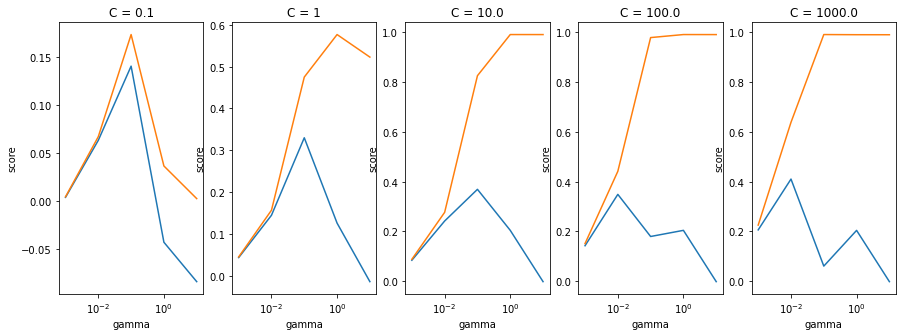

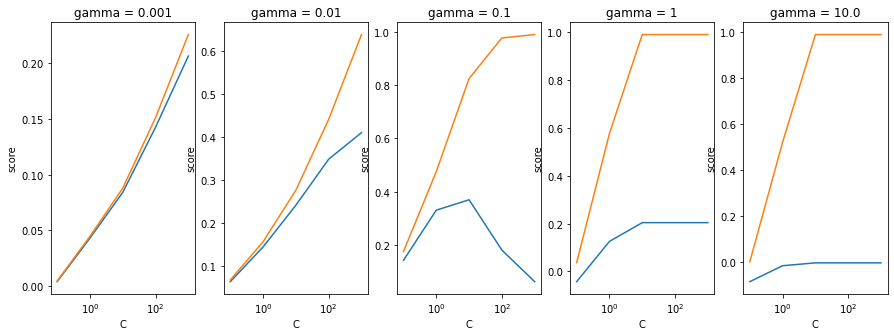

In [35]:
fig = plt.figure(figsize=(15,5))
for idx,c in enumerate(parameters["C"]):
    plt.subplot(1,len(parameters["C"]),idx+1)
    plt.plot(cv_results[cv_results.param_C == c]['param_gamma'],cv_results[cv_results.param_C == c]['mean_test_score'])
    plt.plot(cv_results[cv_results.param_C == c]['param_gamma'],cv_results[cv_results.param_C == c]['mean_train_score'])
    plt.xlabel("gamma")
    plt.xscale('log')
    plt.ylabel("score")
    plt.title("C = {0}".format(c))
plt.show()

fig = plt.figure(figsize=(15,5))
for idx,gamma in enumerate(parameters["gamma"]):
    plt.subplot(1,len(parameters["gamma"]),idx+1)
    plt.plot(cv_results[cv_results.param_gamma == gamma]['param_C'],cv_results[cv_results.param_gamma == gamma]['mean_test_score'])
    plt.plot(cv_results[cv_results.param_gamma == gamma]['param_C'],cv_results[cv_results.param_gamma == gamma]['mean_train_score'])
    plt.xlabel("C")
    plt.xscale('log')
    plt.ylabel("score")
    plt.title("gamma = {0}".format(gamma))
plt.show()

In [36]:
print(gridCV.best_params_)
print(gridCV.best_score_)

{'C': 1000.0, 'gamma': 0.01}
0.4103619911976616


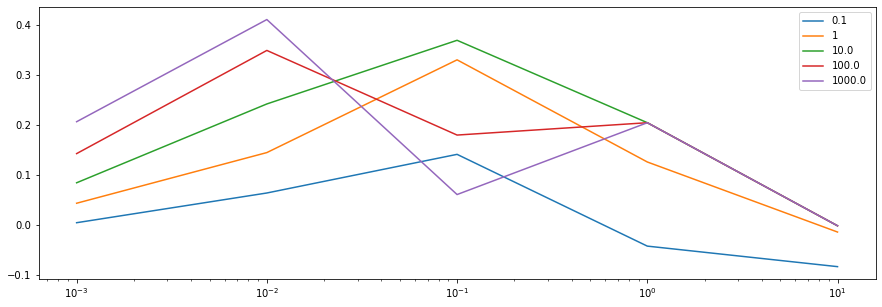

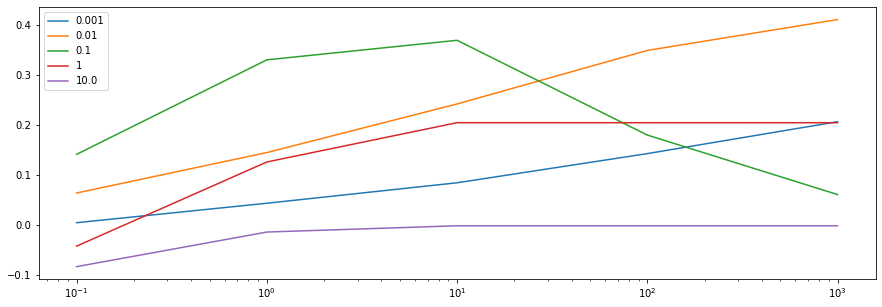

In [37]:
plt.figure(figsize=(15,5))
for c in parameters["C"]:
    #for gamma in parameters["gamma"]:
    plt.plot(cv_results[cv_results.param_C == c]['param_gamma'],cv_results[cv_results.param_C == c]['mean_test_score'])
    plt.xscale('log')
plt.legend(parameters["C"])
plt.show()

plt.figure(figsize=(15,5))
for gamma in parameters["gamma"]:
    #for gamma in parameters["gamma"]:
    plt.plot(cv_results[cv_results.param_gamma == gamma]['param_C'],cv_results[cv_results.param_gamma == gamma]['mean_test_score'])
    plt.xscale('log')
plt.legend(parameters["gamma"])
plt.show()

In [126]:
svr_final = SVR(C=1000, gamma=0.01)
svr_final.fit(train_x, train_y)
svr_final.score(train_x, train_y)

0.6203549123841834

In [127]:
svr_final.score(test_x, test_y)

0.42408922568016216

SVM with tuned hyperparameters was overfitting slightly but gave much better results on test data than linear regression

### Trying tree and ensemble regressors

#### Decision Tree Regressor

In [32]:
dt_model = DecisionTreeRegressor(max_features='auto', min_samples_leaf=18)
parameters = {"max_depth":range(5,16,3),"min_samples_split":range(25,41,3)}
grid_cv = GridSearchCV(dt_model,
                      param_grid=parameters,
                      verbose=1,
                      n_jobs=-1,
                      cv=5,
                      scoring='r2',
                      return_train_score=True)
grid_cv.fit(train_x, train_y)

Fitting 5 folds for each of 24 candidates, totalling 120 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  34 tasks      | elapsed:    3.9s
[Parallel(n_jobs=-1)]: Done 120 out of 120 | elapsed:    6.8s finished


GridSearchCV(cv=5,
             estimator=DecisionTreeRegressor(max_features='auto',
                                             min_samples_leaf=18),
             n_jobs=-1,
             param_grid={'max_depth': range(5, 16, 3),
                         'min_samples_split': range(25, 41, 3)},
             return_train_score=True, scoring='r2', verbose=1)

In [33]:
grid_cv.best_params_

{'max_depth': 14, 'min_samples_split': 25}

In [34]:
grid_cv.best_score_

0.2693883414461745

In [35]:
grid_cv.best_estimator_.score(test_x, test_y)

0.29517527327548054

In [36]:
cv_results = pd.DataFrame(grid_cv.cv_results_)

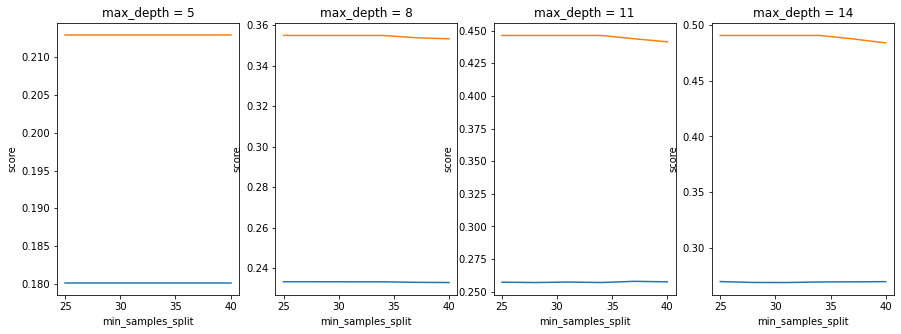

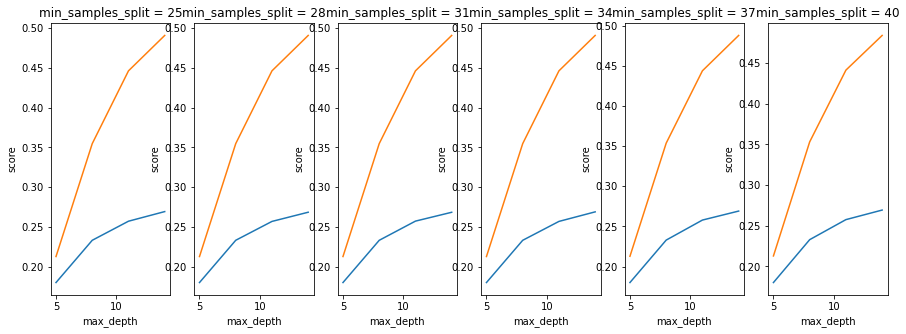

In [37]:

fig = plt.figure(figsize=(15,5))
for idx,d in enumerate(parameters["max_depth"]):
    plt.subplot(1,len(parameters["max_depth"]),idx+1)
    plt.plot(cv_results[cv_results.param_max_depth == d]['param_min_samples_split'],cv_results[cv_results.param_max_depth == d]['mean_test_score'])
    plt.plot(cv_results[cv_results.param_max_depth == d]['param_min_samples_split'],cv_results[cv_results.param_max_depth == d]['mean_train_score'])
    plt.xlabel("min_samples_split")
    plt.ylabel("score")
    plt.title("max_depth = {0}".format(d))
plt.show()

fig = plt.figure(figsize=(15,5))
for idx,s in enumerate(parameters["min_samples_split"]):
    plt.subplot(1,len(parameters["min_samples_split"]),idx+1)
    plt.plot(cv_results[cv_results.param_min_samples_split == s]['param_max_depth'],cv_results[cv_results.param_min_samples_split == s]['mean_test_score'])
    plt.plot(cv_results[cv_results.param_min_samples_split == s]['param_max_depth'],cv_results[cv_results.param_min_samples_split == s]['mean_train_score'])
    plt.xlabel("max_depth")
    plt.ylabel("score")
    plt.title("min_samples_split = {0}".format(s))
plt.show()

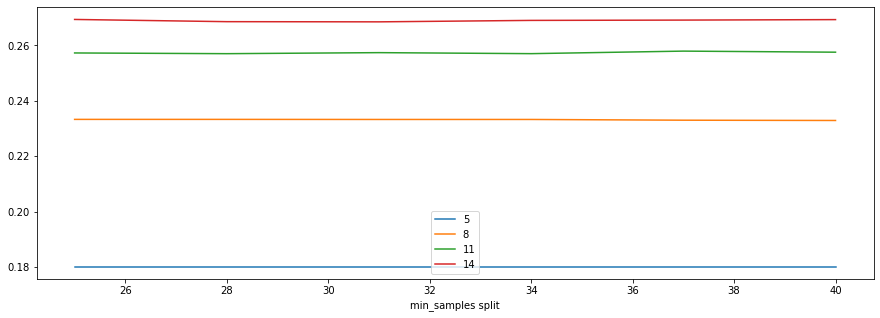

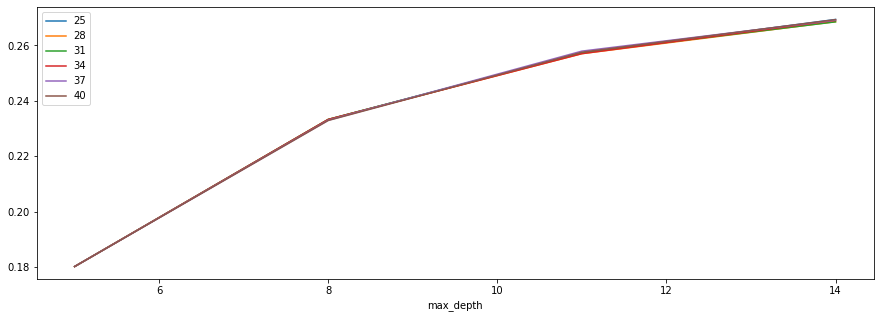

In [38]:
plt.figure(figsize=(15,5))
for c in parameters["max_depth"]:
    #for gamma in parameters["gamma"]:
    plt.plot(cv_results[cv_results.param_max_depth == c]['param_min_samples_split'],cv_results[cv_results.param_max_depth == c]['mean_test_score'])
#     plt.xscale('log')
plt.xlabel('min_samples split')
plt.legend(parameters["max_depth"])
plt.show()

plt.figure(figsize=(15,5))
for gamma in parameters["min_samples_split"]:
    #for gamma in parameters["gamma"]:
    plt.plot(cv_results[cv_results.param_min_samples_split == gamma]['param_max_depth'],cv_results[cv_results.param_min_samples_split == gamma]['mean_test_score'])
#     plt.xscale('log')
plt.xlabel('max_depth')
plt.legend(parameters["min_samples_split"])
plt.show()

Above graphs clearly shows tha min_samples_split has no effect on performance. Will try with min_sample_leaf

In [39]:
dt_model = DecisionTreeRegressor(max_features='auto',min_samples_split=40)
parameters = {"max_depth":range(5,16,3),"min_samples_leaf":range(10,25,3)}
grid_cv = GridSearchCV(dt_model,
                      param_grid=parameters,
                      verbose=1,
                      n_jobs=-1,
                      cv=5,
                      scoring='r2',
                      return_train_score=True)
grid_cv.fit(train_x, train_y)

Fitting 5 folds for each of 20 candidates, totalling 100 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  52 tasks      | elapsed:    1.6s
[Parallel(n_jobs=-1)]: Done 100 out of 100 | elapsed:    3.0s finished


GridSearchCV(cv=5,
             estimator=DecisionTreeRegressor(max_features='auto',
                                             min_samples_split=40),
             n_jobs=-1,
             param_grid={'max_depth': range(5, 16, 3),
                         'min_samples_leaf': range(10, 25, 3)},
             return_train_score=True, scoring='r2', verbose=1)

In [40]:
grid_cv.best_params_

{'max_depth': 14, 'min_samples_leaf': 10}

In [41]:
grid_cv.best_score_

0.2842979897216365

In [42]:
grid_cv.best_estimator_.score(test_x, test_y)

0.3093214314861632

In [43]:
cv_results = pd.DataFrame(grid_cv.cv_results_)

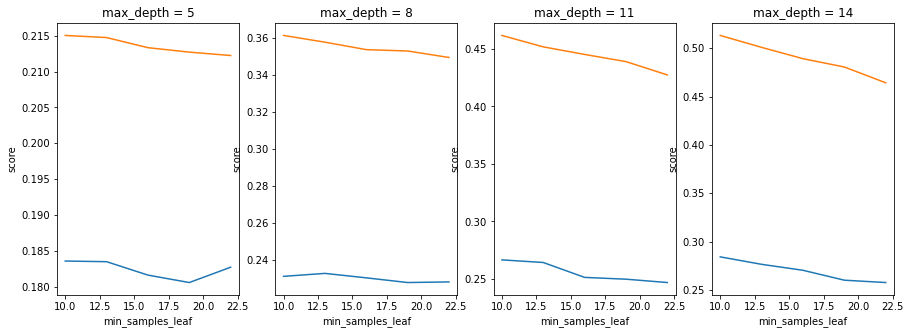

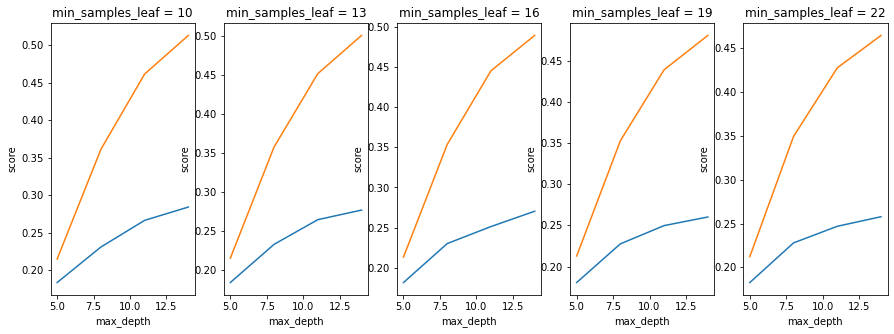

In [44]:
fig = plt.figure(figsize=(15,5))
for idx,d in enumerate(parameters["max_depth"]):
    plt.subplot(1,len(parameters["max_depth"]),idx+1)
    plt.plot(cv_results[cv_results.param_max_depth == d]['param_min_samples_leaf'],cv_results[cv_results.param_max_depth == d]['mean_test_score'])
    plt.plot(cv_results[cv_results.param_max_depth == d]['param_min_samples_leaf'],cv_results[cv_results.param_max_depth == d]['mean_train_score'])
    plt.xlabel("min_samples_leaf")
    plt.ylabel("score")
    plt.title("max_depth = {0}".format(d))
plt.show()

fig = plt.figure(figsize=(15,5))
for idx,s in enumerate(parameters["min_samples_leaf"]):
    plt.subplot(1,len(parameters["min_samples_leaf"]),idx+1)
    plt.plot(cv_results[cv_results.param_min_samples_leaf == s]['param_max_depth'],cv_results[cv_results.param_min_samples_leaf == s]['mean_test_score'])
    plt.plot(cv_results[cv_results.param_min_samples_leaf == s]['param_max_depth'],cv_results[cv_results.param_min_samples_leaf == s]['mean_train_score'])
    plt.xlabel("max_depth")
    plt.ylabel("score")
    plt.title("min_samples_leaf = {0}".format(s))
plt.show()

Best parameters are finalized at max_depth = 14, min_samples_leaf = 19 and min_samples_split = 40.
But R2 score is fixed at around 30%. Below is final tree created using these parameters

In [45]:
final_dt_model = DecisionTreeRegressor(max_depth=14, min_samples_split=40, min_samples_leaf=19)
final_dt_model.fit(train_x, train_y)

DecisionTreeRegressor(max_depth=14, min_samples_leaf=19, min_samples_split=40)

In [46]:
final_dt_model.score(train_x, train_y)

0.49159364693197194

In [47]:
final_dt_model.score(test_x, test_y)

0.3228475450069307

In [95]:
import os
os.environ["PATH"] += os.pathsep + 'C:/Program Files/Graphviz 2.44.1/bin'

In [46]:
dot_data = tree.export_graphviz(final_dt_model, out_file=None, 
                                feature_names=train_x.columns,
                                filled=True)

# Draw graph
graph = graphviz.Source(dot_data, format="png") 
graph.render('decision_tree_output.gv')

'decision_tree_output.gv.png'

In [48]:
feature_importance = pd.Series(final_dt_model.feature_importances_,index=train_x.columns).sort_values(ascending=False)

In [49]:
feature_importance.index

Index(['hour', 'T3', 'lights', 'Press_mm_hg', 'T8', 'RH_9', 'RH_6', 'T2',
       'RH_3', 'week', 'T4', 'Tdewpoint', 'day', 'T_out', 'RH_1', 'T1',
       'month', 'RH_out', 'RH_5', 'RH_8', 'day_of_week', 'T7', 'T5', 'T6',
       'RH_7', 'T9', 'RH_4', 'Windspeed', 'Visibility', 'RH_2', 'minute',
       'rv2', 'rv1', 'second', 'is_weekend'],
      dtype='object')

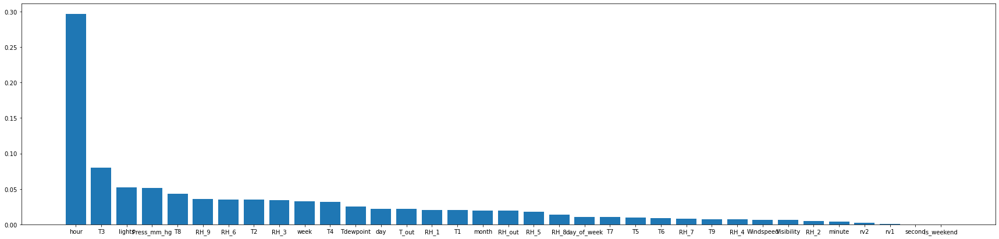

In [50]:
plt.figure(figsize=(30,7))
plt.bar(feature_importance.index, feature_importance)
plt.show()

Hour of the day seems to be the most important factor in deciding energy consumption

Using above configuration slightly better result were achieved than linear regression. Will try bagging and boosting

### Random Forest Regressor

First will try slightly simpler tree parameters than the trained above. Max_depth = 10, min_samples_split = 50, min_samples_leaf = 25 and estimators = 100

In [50]:
rf_model_init = RandomForestRegressor(max_depth=10, min_samples_leaf=25, min_samples_split=50,n_jobs=-1, oob_score=True, random_state=42,verbose=1)
rf_model_init.fit(train_x, train_y)

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  34 tasks      | elapsed:    0.9s
[Parallel(n_jobs=-1)]: Done 100 out of 100 | elapsed:    2.3s finished


RandomForestRegressor(max_depth=10, min_samples_leaf=25, min_samples_split=50,
                      n_jobs=-1, oob_score=True, random_state=42, verbose=1)

In [51]:
rf_model_init.score(train_x, train_y)

[Parallel(n_jobs=8)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 100 out of 100 | elapsed:    0.0s finished


0.42051508791196024

In [52]:
rf_model_init.score(test_x,test_y)

[Parallel(n_jobs=8)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 100 out of 100 | elapsed:    0.0s finished


0.35325787059145874

In [53]:
#out of box score
rf_model_init.oob_score_

0.3330469426962377

Initial random forest bagging model seems to be working better than plain decision tree model

In [74]:
rf_model = RandomForestRegressor(80,max_depth=25, random_state=42, oob_score=True)
parameters = {"min_samples_leaf": range(5,25,2),"min_samples_split": range(20,45,2)}
rf_grid_cv = GridSearchCV(rf_model,
                      param_grid=parameters,
                      verbose=1,
                      n_jobs=4,
                      cv=5,
                      scoring='r2',
                      return_train_score=True)
rf_grid_cv.fit(train_x, train_y)

Fitting 5 folds for each of 130 candidates, totalling 650 fits


[Parallel(n_jobs=4)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done  42 tasks      | elapsed:  2.2min
[Parallel(n_jobs=4)]: Done 192 tasks      | elapsed:  9.0min
[Parallel(n_jobs=4)]: Done 442 tasks      | elapsed: 19.6min
[Parallel(n_jobs=4)]: Done 650 out of 650 | elapsed: 27.7min finished


GridSearchCV(cv=5,
             estimator=RandomForestRegressor(max_depth=25, n_estimators=80,
                                             oob_score=True, random_state=42),
             n_jobs=4,
             param_grid={'min_samples_leaf': range(5, 25, 2),
                         'min_samples_split': range(20, 45, 2)},
             return_train_score=True, scoring='r2', verbose=1)

In [55]:
# with open('rf_grid_cv.pkl','rb') as f:
#     rf_grid_cv = pickle.load(f)

In [75]:
rf_grid_cv.best_estimator_.oob_score_

0.43488078374059747

In [76]:
rf_grid_cv.best_params_

{'min_samples_leaf': 5, 'min_samples_split': 20}

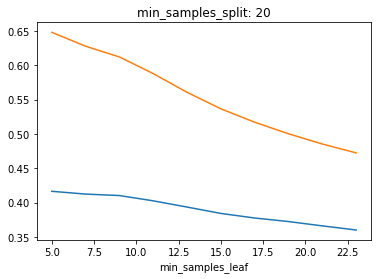

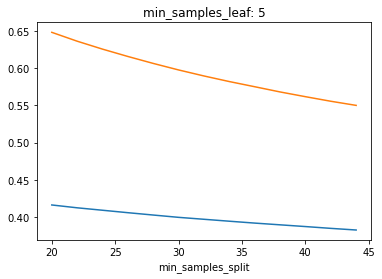

In [132]:
plotGridCV(rf_grid_cv)

In [87]:
import pickle
with open('rf_grid_cv.pkl','wb') as f:
    pickle.dump(rf_grid_cv,f,pickle.HIGHEST_PROTOCOL)

Final Random Forest Regressor model with 100 estimators, max_depth 25, min_samples_leaf 5 and min_samples_split 15

In [129]:
final_rf_model = RandomForestRegressor(100,max_depth=25,min_samples_leaf=5, min_samples_split=15,n_jobs=-1, verbose=1,oob_score=True)
final_rf_model.fit(train_x, train_y)

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  34 tasks      | elapsed:    1.4s
[Parallel(n_jobs=-1)]: Done 100 out of 100 | elapsed:    3.7s finished


RandomForestRegressor(max_depth=25, min_samples_leaf=5, min_samples_split=15,
                      n_jobs=-1, oob_score=True, verbose=1)

In [130]:
final_rf_model.oob_score_

0.45636047843812144

In [131]:
final_rf_model.score(test_x, test_y)

[Parallel(n_jobs=8)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 100 out of 100 | elapsed:    0.0s finished


0.46274990461873333

Random Forest have by far given the best result surpassing SVM

### AdaBoost Regressor

In [88]:
ab_model_init = AdaBoostRegressor()
ab_model_init.fit(train_x, train_y)

AdaBoostRegressor()

In [90]:
ab_model_init.score(test_x,test_y)

-0.24395497499058538

Negative R-squared achieved. Signifies that initial model is performing very poorly.

In [91]:
ab_model_init.score(train_x, train_y)

-0.20173513661079334

Will try with our final decision tree model as base model for AdaBoostRegressor

In [92]:
ab_model = AdaBoostRegressor(final_dt_model)
ab_model.fit(train_x, train_y)

AdaBoostRegressor(base_estimator=DecisionTreeRegressor(max_depth=14,
                                                       min_samples_leaf=19,
                                                       min_samples_split=40))

In [93]:
ab_model.score(test_x, test_y)

0.456746987413842

In [94]:
ab_model.score(train_x, train_y)

0.8062710215962181

This strategy gave better results on test data but was clear overfitting.

In [115]:
ab_model = AdaBoostRegressor(DecisionTreeRegressor(),loss="exponential",random_state=42)
parameters = {"base_estimator__max_depth":range(10,25,2),
              "n_estimators":range(90,151,10),}
ab_grid_cv = GridSearchCV(ab_model,
                      param_grid=parameters,
                      verbose=1,
                      n_jobs=6,
                      cv=5,
                      scoring='r2',
                      return_train_score=True)
ab_grid_cv.fit(train_x, train_y)

Fitting 5 folds for each of 56 candidates, totalling 280 fits


[Parallel(n_jobs=6)]: Using backend LokyBackend with 6 concurrent workers.
[Parallel(n_jobs=6)]: Done  38 tasks      | elapsed:  2.6min
[Parallel(n_jobs=6)]: Done 188 tasks      | elapsed: 15.2min
[Parallel(n_jobs=6)]: Done 280 out of 280 | elapsed: 25.1min finished


GridSearchCV(cv=5,
             estimator=AdaBoostRegressor(base_estimator=DecisionTreeRegressor(),
                                         loss='exponential', random_state=42),
             n_jobs=6,
             param_grid={'base_estimator__max_depth': range(10, 25, 2),
                         'n_estimators': range(90, 151, 10)},
             return_train_score=True, scoring='r2', verbose=1)

In [116]:
ab_grid_cv.best_params_

{'base_estimator__max_depth': 14, 'n_estimators': 150}

In [117]:
ab_grid_cv.best_score_

0.5085791012416895

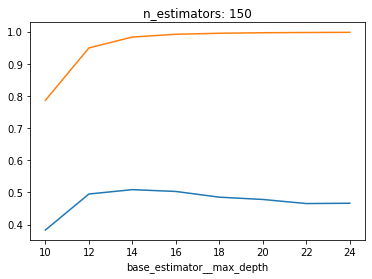

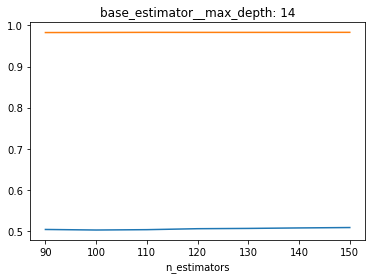

In [130]:
plotGridCV(ab_grid_cv)

In [119]:
ab_grid_cv.best_estimator_.score(test_x, test_y)

0.5716023478307612

In [120]:
ab_grid_cv.best_estimator_.score(train_x, train_y)

0.9830748358092483

Final AdaBoostModel with max_depth of base estimator set as 14 and exponential loss function

In [133]:
ada_model_final = AdaBoostRegressor(DecisionTreeRegressor(max_depth=14),loss="exponential",random_state=42)

In [134]:
ada_model_final.fit(train_x, train_y)

AdaBoostRegressor(base_estimator=DecisionTreeRegressor(max_depth=14),
                  loss='exponential', random_state=42)

In [135]:
ada_model_final.score(test_x, test_y)

0.55223912574679

In [136]:
ada_model_final.score(train_x, train_y)

0.9790939675069648

AdaBoost Model is overfitting heavily but have given best scores on test data

### Gradient Boosting Regressor

In [125]:
gb_model_init = GradientBoostingRegressor()
gb_model_init.fit(train_x, train_y)

GradientBoostingRegressor()

In [126]:
gb_model_init.score(test_x, test_y)

0.33050828292368173

In [127]:
gb_model_init.score(train_x, train_y)

0.36066610986689684

Initial model gave very promising results

In [68]:
gb_model = GradientBoostingRegressor(random_state=42)
parameters = {"max_depth": range(5,20,2),
              "n_estimators": range(50,160,10)}
gb_grid_cv = GridSearchCV(gb_model,
                      param_grid=parameters,
                      verbose=1,
                      n_jobs=6,
                      cv=5,
                      scoring='r2',
                      return_train_score=True)
gb_grid_cv.fit(train_x, train_y)

Fitting 5 folds for each of 1 candidates, totalling 5 fits


[Parallel(n_jobs=6)]: Using backend LokyBackend with 6 concurrent workers.
[Parallel(n_jobs=6)]: Done   5 out of   5 | elapsed:   36.9s finished


GridSearchCV(cv=5,
             estimator=GradientBoostingRegressor(max_depth=11, n_estimators=150,
                                                 random_state=42),
             n_jobs=6, param_grid={}, return_train_score=True, scoring='r2',
             verbose=1)

In [118]:
gb_grid_cv.best_params_

{'max_depth': 11, 'n_estimators': 150}

In [119]:
gb_grid_cv.best_score_

0.48230152299538076

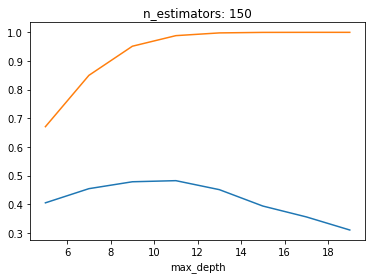

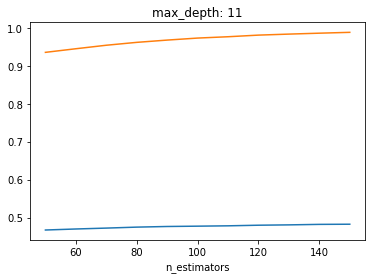

In [120]:
plotGridCV(gb_grid_cv_spl)

In [121]:
gb_grid_cv.best_estimator_.score(test_x, test_y)

0.8047175982865804

In [122]:
gb_grid_cv.best_estimator_.score(train_x, train_y)

0.8370242912207264

In [138]:
final_gb_model = gb_grid_cv.best_estimator_

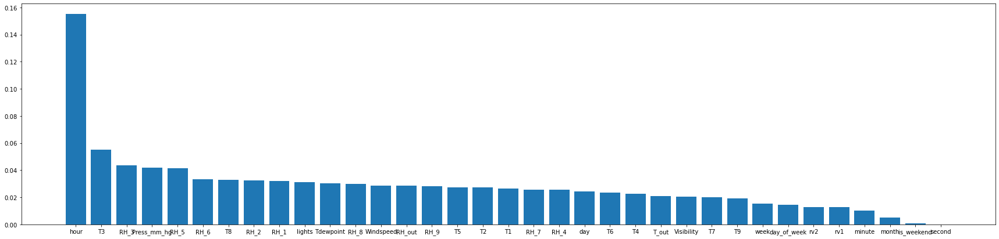

In [139]:
feature_importance = pd.Series(final_gb_model.feature_importances_,index=train_x.columns).sort_values(ascending=False)

plt.figure(figsize=(30,7))
plt.bar(feature_importance.index, feature_importance)
plt.show()

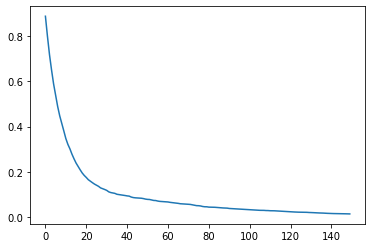

In [140]:
train_score = pd.Series(final_gb_model.train_score_)
plt.plot(train_score)
plt.show()

Gradient Boosting Regressor gave very good performance as compared to all other models. Test R-squared score of 80% was achieved. Comparing all models performance below

In [141]:
train_scores = [lr_model.score(train_x, train_y),
               svr_final.score(train_x, train_y),
               final_dt_model.score(train_x, train_y),
               final_rf_model.score(train_x, train_y),
               ada_model_final.score(train_x, train_y),
               final_gb_model.score(train_x, train_y)]
test_scores = [lr_model.score(test_x, test_y),
               svr_final.score(test_x, test_y),
               final_dt_model.score(test_x, test_y),
               final_rf_model.score(test_x, test_y),
               ada_model_final.score(test_x, test_y),
               final_gb_model.score(test_x, test_y)]
models = ['Linear Regression','SVR','DecisionTree','Random Forest','AdaBoost','GradientBoost']

[Parallel(n_jobs=8)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 100 out of 100 | elapsed:    0.0s finished
[Parallel(n_jobs=8)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 100 out of 100 | elapsed:    0.0s finished


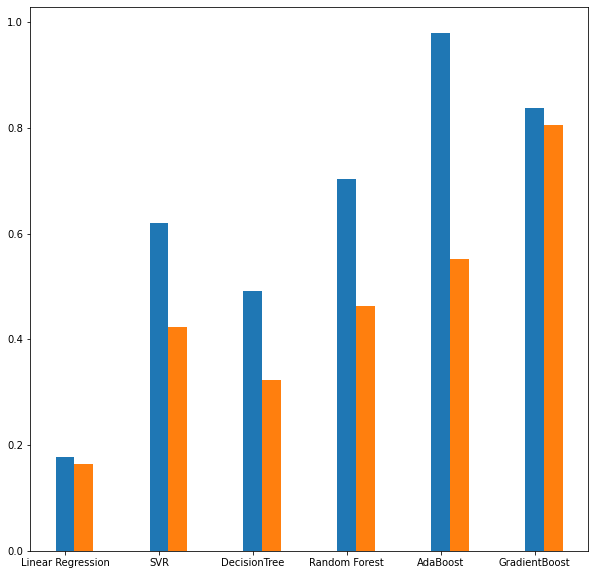

In [149]:
plt.figure(figsize=(10,10))
plt.bar(range(len(models)),train_scores,0.2)
plt.bar([x+0.2 for x in range(len(models))],test_scores,0.2)
plt.xticks(range(len(models)),models)
plt.show()

### Trying Neural Network

In [18]:
from tensorflow import keras
from tensorflow.keras import layers
from sklearn.metrics import r2_score

In [19]:
train_x.shape

(13814, 35)

In [150]:
input_layer = keras.Input((35,))
fc_layer1 = layers.Dense(256,activation='relu')(input_layer)
drop_out1 = layers.Dropout(0.5)(fc_layer1)
fc_layer2 = layers.Dense(128,activation='relu')(drop_out1)
drop_out2 = layers.Dropout(0.5)(fc_layer2)
fc_layer3 = layers.Dense(32,activation='relu')(drop_out2)
output_layer = layers.Dense(1,activation='linear')(fc_layer3)
model = keras.Model(input_layer,output_layer,name='energy_consumption_model')

model.summary()

model.compile(optimizer=keras.optimizers.RMSprop(learning_rate=0.0005),loss=keras.losses.MeanSquaredError())

Model: "energy_consumption_model"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_34 (InputLayer)        [(None, 35)]              0         
_________________________________________________________________
dense_128 (Dense)            (None, 256)               9216      
_________________________________________________________________
dropout_50 (Dropout)         (None, 256)               0         
_________________________________________________________________
dense_129 (Dense)            (None, 128)               32896     
_________________________________________________________________
dropout_51 (Dropout)         (None, 128)               0         
_________________________________________________________________
dense_130 (Dense)            (None, 32)                4128      
_________________________________________________________________
dense_131 (Dense)            (None, 1)    

In [151]:
history = model.fit(train_x, train_y,batch_size=64,epochs=100,validation_split=0.2)

Epoch 1/100
173/173 [==============================] - 0s 3ms/step - loss: 0.9990 - val_loss: 0.9033
Epoch 2/100
173/173 [==============================] - 0s 2ms/step - loss: 0.9397 - val_loss: 0.8817
Epoch 3/100
173/173 [==============================] - 0s 3ms/step - loss: 0.9078 - val_loss: 0.8593
Epoch 4/100
173/173 [==============================] - 0s 2ms/step - loss: 0.8831 - val_loss: 0.8403
Epoch 5/100
173/173 [==============================] - 0s 2ms/step - loss: 0.8756 - val_loss: 0.8249
Epoch 6/100
173/173 [==============================] - 0s 2ms/step - loss: 0.8542 - val_loss: 0.8121
Epoch 7/100
173/173 [==============================] - 0s 2ms/step - loss: 0.8427 - val_loss: 0.8001
Epoch 8/100
173/173 [==============================] - 0s 2ms/step - loss: 0.8276 - val_loss: 0.7948
Epoch 9/100
173/173 [==============================] - 0s 2ms/step - loss: 0.8178 - val_loss: 0.7731
Epoch 10/100
173/173 [==============================] - 0s 2ms/step - loss: 0.8044 - val_lo

173/173 [==============================] - 0s 2ms/step - loss: 0.5915 - val_loss: 0.6787
Epoch 82/100
173/173 [==============================] - 0s 2ms/step - loss: 0.5930 - val_loss: 0.6692
Epoch 83/100
173/173 [==============================] - 0s 3ms/step - loss: 0.5998 - val_loss: 0.6619
Epoch 84/100
173/173 [==============================] - 0s 3ms/step - loss: 0.6051 - val_loss: 0.6621
Epoch 85/100
173/173 [==============================] - 0s 2ms/step - loss: 0.5970 - val_loss: 0.6688
Epoch 86/100
173/173 [==============================] - 0s 2ms/step - loss: 0.5945 - val_loss: 0.6673
Epoch 87/100
173/173 [==============================] - 0s 2ms/step - loss: 0.5934 - val_loss: 0.6622
Epoch 88/100
173/173 [==============================] - 0s 2ms/step - loss: 0.5919 - val_loss: 0.6640
Epoch 89/100
173/173 [==============================] - 0s 2ms/step - loss: 0.5883 - val_loss: 0.6611
Epoch 90/100
173/173 [==============================] - 0s 2ms/step - loss: 0.5883 - val_loss: 

In [152]:
train_y_pred = model.predict(train_x)
print("training R-squared score:", r2_score(train_y, train_y_pred))

training R-squared score: 0.4596159361401805


In [153]:
test_y_pred = model.predict(test_x)
print("testing R-squared score:", r2_score(test_y, test_y_pred))

testing R-squared score: 0.3257046455963585


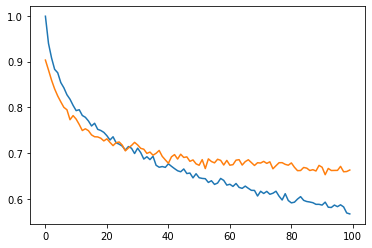

In [154]:
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.show()

Simple Neural Network doesnt seem perform better.